In [1]:
import folium
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
pd.set_option('display.max_columns', 500)
coordinates = 'coordinates/PAK_Settlements_NGA_2017_20181122.dbf'
API = 'https://archive-api.open-meteo.com/v1/archive?latitude=52.52&longitude=13.41&start_date=2023-06-06&end_date=2023-06-20&hourly=temperature_2m'
import scipy
from shapely.wkt import loads
import xarray as xr
import numpy as np
import folium.plugins as plugins

In [2]:
table = gpd.read_file('coordinates/settlements/PAK_Settlements_NGA_2017_20181122.dbf')
df_settlements = pd.DataFrame(table)


In [3]:
test_tehsil = df_settlements['TEHSIL'].unique()[5]

In [4]:
df_teh = df_settlements.loc[df_settlements['TEHSIL'] == test_tehsil]

In [5]:
df_teh.head()

,FID_Settle,RC,UFI,UNI,LAT,LONG,DMS_LAT,DMS_LONG,MGRS,JOG,FC,DSG,PC,CC1,ADM1,POP,ELEV,CC2,NT,LC,SHORT_FORM,GENERIC,SORT_NAME_,FULL_NAME_,FULL_NAME1,SORT_NAME1,FULL_NAM_1,FULL_NAM_2,NOTE,MODIFY_DAT,DISPLAY,NAME_RANK,NAME_LINK,TRANSL_CD,NM_MODIFY_,F_EFCTV_DT,F_TERM_DT,FID_Pak_ad,PROVINCE,PROVINCE_C,DISTRICT,DISTRICT_C,TEHSIL,TEHSIL_C,Remarks,hfs,geometry
763,58547,5,10844352.0,11759808.0,24.191300,70.006200,24:11:29N,70:00:22E,42RXM0219375774,NG42-15,L,LCTY,NaN,PK,5,NaN,NaN,NaN,N,NaN,NaN,NaN,CHHAD,Chhād,Chhad,CHHAD,Chhād,Chhad,NaN,2010-07-22,"1,2,3,4,5",1.0,0.0,NaN,2010-07-22,NaN,NaN,20,Sindh,8.0,Tharparkar,821,Mithi,82103.0,NaN,0,POINT (70.00620 24.19131)
1372,125457,5,13547737.0,17145167.0,24.287523,70.058678,24:17:15N,70:03:31E,42RXM0744386468,NG42-15,S,PSTP,NaN,PK,5,NaN,NaN,NaN,N,NaN,NaN,NaN,TIRARRANGERSPOST,Tirār Rangers Post,Tirar Rangers Post,TIRARRANGERSPOST,Tirār Rangers Post,Tirar Rangers Post,NaN,2015-12-15,"1,2",1.0,0.0,NaN,2015-12-15,NaN,NaN,20,Sindh,8.0,Tharparkar,821,Mithi,82103.0,NaN,0,POINT (70.05870 24.28751)
1444,146332,5,13542723.0,17135252.0,24.296936,69.952793,24:17:49N,69:57:10E,42RWM9668987433,NG42-15,P,PPL,NaN,PK,5,NaN,NaN,NaN,N,NaN,NaN,NaN,RAGARIL,Rāgāril,Ragaril,RAGARIL,Rāgāril,Ragaril,NaN,2015-12-09,"1,2",1.0,0.0,NaN,2015-12-09,NaN,NaN,20,Sindh,8.0,Tharparkar,821,Mithi,82103.0,NaN,0,POINT (69.95280 24.29691)
1448,139832,5,10844250.0,11759706.0,24.297290,70.068169,24:17:50N,70:04:05E,42RXM0839887557,NG42-15,P,PPL,NaN,PK,5,NaN,NaN,NaN,N,NaN,NaN,NaN,TIRAR,Tirār,Tirar,TIRAR,Tirār,Tirar,NaN,2015-12-15,"1,2,3,4,5",1.0,0.0,NaN,2010-07-22,NaN,NaN,20,Sindh,8.0,Tharparkar,821,Mithi,82103.0,NaN,0,POINT (70.06820 24.29731)
1463,147004,5,10844950.0,11761552.0,24.298893,69.920497,24:17:56N,69:55:14E,42RWM9341087628,NG42-15,P,PPL,NaN,PK,5,NaN,NaN,NaN,V,NaN,NaN,NaN,VINGI,Vingi,Vingi,VINGI,Vingi,Vingi,NaN,2015-12-09,"1,2,3,4,5",0.0,0.0,NaN,2015-12-09,NaN,NaN,20,Sindh,8.0,Tharparkar,821,Mithi,82103.0,NaN,0,POINT (69.92060 24.29891)


In [6]:
m = folium.Map(location=[df_teh.iloc[0]['LAT'], df_teh.iloc[0]['LONG']], zoom_start=8)

In [7]:
m

In [8]:
# for i in range(0, len(df_teh)):
#     folium.Marker([df_teh.iloc[i]['LAT'], df_teh.iloc[i]['LONG']]).add_to(m)

In [9]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
area = world[world.name == 'Pakistan']

area = area.to_crs(epsg=3395)    # convert to World Mercator CRS
area_shape = area.iloc[0].geometry   # get the Polygon

/var/folders/ml/57p2p5r56p35n0ttkg342kmw0000gn/T/ipykernel_20996/497639970.py:1: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


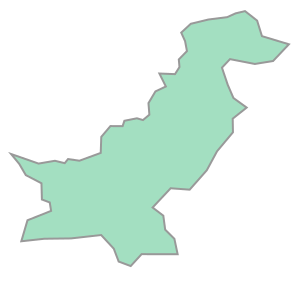

In [10]:
area_shape

In [11]:
adm0 = gpd.read_file('coordinates/adm0/geoBoundaries-PAK-ADM0_simplified.dbf')
adm1 = gpd.read_file('coordinates/adm0/geoBoundaries-PAK-ADM0_simplified.dbf')
adm2 = gpd.read_file('coordinates/adm1/geoBoundaries-PAK-ADM1_simplified.dbf')
adm3 = gpd.read_file('coordinates/adm3/geoBoundaries-PAK-ADM3_simplified.dbf')

df_adm0 = pd.DataFrame(adm0)
df_adm1 = pd.DataFrame(adm1)
df_adm2 = pd.DataFrame(adm2)
df_adm3 = pd.DataFrame(adm3)

In [12]:
def plot_df(df, with_popup=True):
    map = folium.Map(location=['30.3753', '69.3451'], zoom_start = 5)
    for i, r in df.iterrows():
        geo_json = folium.GeoJson(r['geometry'], style_function=lambda x: {"fillColor": "orange"})
        if with_popup == True:
            popup = folium.Popup(r['shapeName']).add_to(geo_json)
        else:
            continue
        geo_json.add_to(map)
    return map

In [13]:
adm0_map = plot_df(df_adm0)
adm0_map

In [14]:
adm1_map = plot_df(df_adm1)
adm1_map

In [15]:
adm2_map = plot_df(df_adm2)
adm2_map

In [16]:
adm3_map = plot_df(df_adm3)
adm3_map

Now let's inspect if they work with some of the markers from the tehsils.

In [17]:
len(df_adm3['shapeName'].unique())

552

It seems that tehsils and ADM3 districts are not aligned unfortunately. So I turn to estimating the boundaries of the tehsils using the settlement data we have.

In [18]:
from shapely.geometry import Point
from shapely.geometry import MultiPoint
from shapely.geometry import MultiPolygon
from shapely.geometry import Polygon
from scipy.spatial import Voronoi, voronoi_plot_2d
import matplotlib.pyplot as plt


In [19]:
def arr_points(df):
    # given a df of a tehsil find the region boundaries
    points = [Point(long, lat) for long, lat in zip(df['LONG'], df['LAT'])]
    multi_point = MultiPoint(points)
    convex_hull = multi_point.convex_hull
    region_boundary = convex_hull
    return region_boundary
print(arr_points(df_teh))

POLYGON ((70.0062 24.1913, 69.399512 24.836562, 69.565286 24.961723, 70.2324 24.9043, 70.470062 24.879034, 70.531965 24.852868, 70.548024 24.834915, 70.586684 24.703503, 70.485302 24.416827, 70.46297 24.392257, 70.0062 24.1913))


In [20]:
TEHSIL = df_settlements['TEHSIL'].unique()
regions = []
for teh in TEHSIL:
    df_ = df_settlements.loc[df_settlements['TEHSIL'] == teh]
    region_polygon = arr_points(df_)
    regions.append({'shapeName': teh, 'geometry': region_polygon})

In [21]:
df_regions = pd.DataFrame(regions)
df_regions

,shapeName,geometry
0,Shah Bander,"POLYGON ((68.082169 23.773188, 67.783661 23.84..."
1,Kharochan,"POLYGON ((67.685837 23.827905, 67.5 23.916667,..."
2,Jati,"POLYGON ((68.436274 23.968767, 68.205069 24.07..."
3,Keti Bander,"POLYGON ((67.434443 23.992471, 67.363817 24.11..."
4,Ghorabari,"POLYGON ((67.533563 24.161168, 67.383919 24.24..."
...,...,...
428,Pattan,"POLYGON ((72.8025 35.089167, 72.77063 35.13310..."
429,Chitral,"POLYGON ((71.66562 35.220467, 71.632374 35.226..."
430,Kalkot,"POLYGON ((72.143943 35.286214, 72.103099 35.54..."
431,Kalam,"POLYGON ((72.761111 35.336111, 72.406414 35.38..."


In [55]:
df_regions['shapeName'] = df_regions['shapeName'].apply(lambda x: x.lower())

In [56]:
# df_regions.to_csv('shapeNamePolygons.csv')

In [57]:
helena = pd.read_csv('helena_tehsils_correct.csv')
helena['Correct_Tehsil'] = helena['Correct_Tehsil'].apply(lambda x: x.lower())
helena

,District,Tehsil,Correct_Tehsil
0,bahawalpur,Kairpur Tamewali,khairpur tamewali
1,bahawalpur,Hasilpur,hasilpur
2,bahawalpur,Ahmadupr East,ahmadpur east
3,bahawalpur,Yazman,yazman
4,bahawalpur,Bahawalpur,bahawalpur
5,bhawalnagar,Bahawalnagar,bahawalnagar
6,bhawalnagar,Chishtian,chishtian
7,bhawalnagar,Fort Abbas,fort abbas
8,bhawalnagar,Haroonabad,haroonabad
9,bhawalnagar,Minchinabad,minchinabad


In [62]:
helena

,District,Tehsil,Correct_Tehsil
0,bahawalpur,Kairpur Tamewali,khairpur tamewali
1,bahawalpur,Hasilpur,hasilpur
2,bahawalpur,Ahmadupr East,ahmadpur east
3,bahawalpur,Yazman,yazman
4,bahawalpur,Bahawalpur,bahawalpur
5,bhawalnagar,Bahawalnagar,bahawalnagar
6,bhawalnagar,Chishtian,chishtian
7,bhawalnagar,Fort Abbas,fort abbas
8,bhawalnagar,Haroonabad,haroonabad
9,bhawalnagar,Minchinabad,minchinabad


In [67]:
df_regions['shapeName']

0      shah bander
1        kharochan
2             jati
3      keti bander
4        ghorabari
          ...     
428         pattan
429        chitral
430         kalkot
431          kalam
432         mastuj
Name: shapeName, Length: 433, dtype: object

In [66]:
# len(list(set(helena['Correct_Tehsil']) & set(df_regions['shapeName'])))

uncommon = list(set(df_regions['shapeName']).intersection(helena['Correct_Tehsil']))
uncommon

['chishtian',
 'bahawalpur',
 'multan saddar',
 'hasilpur',
 'fort abbas',
 'layyah',
 'alipur',
 'jatoi',
 'lodhran',
 'multan city',
 'mian channu',
 'jampur',
 'burewala',
 'jahanian',
 'muzaffargarh',
 'yazman',
 'rahim yar khan',
 'kot addu',
 'minchinabad',
 'bahawalnagar',
 'haroonabad',
 'rajanpur',
 'rojhan',
 'mailsi',
 'kabirwala',
 'chaubara',
 'khanewal',
 'karor lal esan',
 'dera ghazi khan',
 'sadiqabad',
 'vehari',
 'jalalpur pirwala',
 'taunsa']

In [58]:
test = df_regions['shapeName'].isin(helena['Correct_Tehsil'])
# f_main[df_main['A'].isin(df_filter['Filter_Column'])]


0      False
1      False
2      False
3      False
4      False
       ...  
428    False
429    False
430    False
431    False
432    False
Name: shapeName, Length: 433, dtype: bool

In [22]:
teh_map = plot_df(df_regions)
teh_map

Concave hull function doesn't seem that great.. mostly due to the fact that it doesn't consider other boundaries. So let's combine it with KMeans clustering

In [23]:
import numpy as np
from sklearn.cluster import KMeans
from shapely.geometry import MultiPoint, Polygon
from shapely.ops import cascaded_union
from alphashape import alphashape
import geopandas as gpd
from tqdm import tqdm
from scipy.spatial import Voronoi, voronoi_plot_2d

In [24]:
n_tehsil = len(df_settlements['TEHSIL'].unique())
coordinates_sett = df_settlements[['LAT', 'LONG']].values

kmeans = KMeans(n_clusters=n_tehsil, random_state=0)
cluster_labels = kmeans.fit_predict(coordinates_sett)

df_settlements['Cluster'] = cluster_labels

/opt/homebrew/Caskroom/miniforge/base/envs/pakistan/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [25]:
# Group the points by cluster label
df = df_settlements

# Grouping points by cluster labels
clusters = df.groupby('Cluster')

cluster_map = folium.Map(location=[df['LAT'].mean(), df['LONG'].mean()], zoom_start=8)

# Generate alpha shapes for each cluster and add them to the map
for label, cluster_points in clusters:
    subset_coords = cluster_points[['LONG', 'LAT']].values
    alpha = 0.5  # Adjust the alpha value as per your requirement
    concave_hull = alphashape(subset_coords, alpha)
    
    # Convert the coordinates to a list of tuples for folium
    hull_coords = [(point[1], point[0]) for point in list(concave_hull.exterior.coords)]
    
    # Add the polygon to the map
    folium.Polygon(locations=hull_coords, color='red', fill_opacity=0.3).add_to(cluster_map)

cluster_map

DBSCAN does not appear to be a good method to do this. Makes sense that clustering algorithms aren't the best for generating weird human made boundary shapes. It might also just be that there are to many data points, since in the file there are 260.000 settlements.

In [26]:
# let's load the file helena had.

df_helena = pd.read_csv('data/helena_tehsils.csv')
df_helena

,District,Tehsil
0,bahawalpur,Kairpur Tamewali
1,bahawalpur,Hasilpur
2,bahawalpur,Ahmadupr East
3,bahawalpur,Yazman
4,bahawalpur,Bahawalpur
5,bhawalnagar,Bahawalnagar
6,bhawalnagar,Chishtian
7,bhawalnagar,Fort Abbas
8,bhawalnagar,Haroonabad
9,bhawalnagar,Minchinabad


In [27]:
unique_teh = df_helena['Tehsil'].unique()
distribution = []
for teh in unique_teh:
    n_set = len(df_settlements.loc[df_settlements['TEHSIL'] == teh])
    distribution.append({
        'name': teh,
        'number_sett': n_set
    })
distribution = pd.DataFrame(distribution)


Text(0, 0.5, 'Number of settlements')

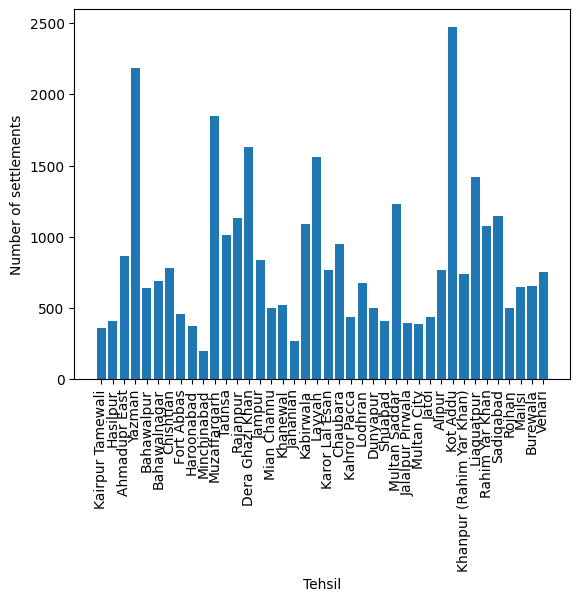

In [28]:
plt.bar(x=distribution['name'], height=distribution['number_sett'])
plt.xticks(rotation=90)
plt.xlabel('Tehsil')
plt.ylabel('Number of settlements')

Let's visualize it on the map

In [29]:
df_adm3['shapeName'] = df_adm3['shapeName'].apply(lambda x: x.lower())
df_helena['Tehsil'] = df_helena['Tehsil'].apply(lambda x: x.lower())
df_adm3.head()

,shapeName,shapeISO,shapeID,shapeGroup,shapeType,geometry
0,bagh,NaN,9618217B15374795339605,PAK,ADM3,"POLYGON ((73.91750 34.01999, 73.93393 34.01103..."
1,dheerkot,NaN,9618217B36543758176465,PAK,ADM3,"POLYGON ((73.69445 34.06935, 73.69492 34.06641..."
2,barnala,NaN,9618217B52678377884784,PAK,ADM3,"POLYGON ((74.29135 33.03087, 74.29782 33.02683..."
3,bhimber,NaN,9618217B77543092347595,PAK,ADM3,"POLYGON ((74.17424 33.01268, 74.17370 32.99613..."
4,samahni,NaN,9618217B53987596255132,PAK,ADM3,"POLYGON ((74.29135 33.03087, 74.27545 33.02197..."


In [30]:
teh_helena = df_helena['Tehsil']
teh_adms = df_adm3['shapeName']

correct = []
mistake = []
for teh in teh_helena:
    if teh in teh_adms:
        correct.append(teh)
    else:
        mistake.append(teh)
print(len(correct))
print(len(mistake))

0
40


Something is wrong.

In [31]:
gad_file = gpd.read_file('data/gadm41_PAK_3.json')
gad_file

,GID_3,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,GID_2,NAME_2,NL_NAME_2,NAME_3,VARNAME_3,NL_NAME_3,TYPE_3,ENGTYPE_3,CC_3,HASC_3,geometry
0,Z06.1.1.1_1,Z06,Pakistan,Z06.1_1,AzadKashmir,NA,Z06.1.1_1,AzadKashmir,NA,Bagh,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((73.49440 34.12510, 73.51480 34..."
1,Z06.1.1.2_1,Z06,Pakistan,Z06.1_1,AzadKashmir,NA,Z06.1.1_1,AzadKashmir,NA,Bhimber,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((73.87490 33.22530, 73.87490 33..."
2,Z06.1.1.3_1,Z06,Pakistan,Z06.1_1,AzadKashmir,NA,Z06.1.1_1,AzadKashmir,NA,Kotli,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((74.01400 33.25090, 73.98950 33..."
3,Z06.1.1.4_1,Z06,Pakistan,Z06.1_1,AzadKashmir,NA,Z06.1.1_1,AzadKashmir,NA,Mirpur,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((73.87490 33.22530, 73.87490 33..."
4,Z06.1.1.5_1,Z06,Pakistan,Z06.1_1,AzadKashmir,NA,Z06.1.1_1,AzadKashmir,NA,Muzaffarabad,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((73.88980 34.04240, 73.85390 34..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
136,PAK.8.6.1_1,PAK,Pakistan,PAK.8_1,Sindh,NA,PAK.8.6_1,Sukkur,NA,Ghotki,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((70.18080 27.85510, 70.15700 27..."
137,PAK.8.6.2_1,PAK,Pakistan,PAK.8_1,Sindh,NA,PAK.8.6_1,Sukkur,NA,Khairpur,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((69.54260 27.08330, 69.51320 27..."
138,PAK.8.6.3_1,PAK,Pakistan,PAK.8_1,Sindh,NA,PAK.8.6_1,Sukkur,NA,NaushahroFiroz,NA,NA,District,District,NA,NA,"MULTIPOLYGON (((67.92080 26.53980, 67.91800 26..."
139,PAK.8.6.4_1,PAK,Pakistan,PAK.8_1,Sindh,NA,PAK.8.6_1,Sukkur,NA,NawabShah,Nawabshah,NA,District,District,NA,NA,"MULTIPOLYGON (((67.91360 26.30040, 67.89980 26..."


In [32]:
# # Let's plot the file from the BOX
# gad_map = plot_df(gad_file, with_popup=False)
# gad_map

In [33]:
for teh in unique_teh[:2]:
    frame = df_settlements.loc[df_settlements['TEHSIL'] == teh]
    for index, sett in frame.iterrows():
        # Let's check if the Settlement is in the district that we are interested in.
        point = Point(sett['LONG'], sett['LAT'])
        polygon = Polygon(frame['geometry'])
        if polygon.contains(point):
            folium.Marker(location=[sett['LAT'], sett['LONG']], popup=sett['TEHSIL']).add_to(adm3_map)
adm3_map

Hmm it seems that there are 4 boundaries within this that seem to work.

Let's look at another data source to see if we can cross reference

In [34]:
df_kaggle = pd.read_excel('data/Tehsil Data Pakistan.xls')

In [35]:
df_kaggle['Tehsil'] = df_kaggle['Tehsil'].apply(lambda x: x.lower())
df_kaggle.head()

,Tehsil,District,Provinces,Country,Valid On,Longitude,Latitude
0,bagh,Bagh,Azad Kashmir,Pakistan,2022-09-09,73.881070,33.957828
1,dhir kot,Bagh,Azad Kashmir,Pakistan,2022-09-09,73.586577,34.019918
2,harighel,Bagh,Azad Kashmir,Pakistan,2022-09-09,73.742435,33.982418
3,barnala,Bhimber,Azad Kashmir,Pakistan,2022-09-09,74.216224,32.942963
4,bhimber,Bhimber,Azad Kashmir,Pakistan,2022-09-09,74.001019,33.017291


In [36]:
for x, row in df_kaggle.iterrows():
    # print(row['Latitude'])
    icon=folium.Icon(color='red')
    folium.Marker(location=[row['Latitude '], row['Longitude']], popup=row['Tehsil'], icon=icon).add_to(adm3_map)

In [37]:
adm3_map

ADM3 Map seems to be correct on tehsil locations. So let's use adm3 map and evenly draw data from the API.

In [38]:
# Given a polygon compute points of equal distance apart.
gps_adm0 = gpd.read_file('coordinates/adm0/geoBoundaries-PAK-ADM0_simplified.dbf')
bounds_pak = gps_adm0.total_bounds

from shapely.geometry import box

pakistan_box = box(*bounds_pak)
print(pakistan_box)

POLYGON ((77.12039140000005 23.804705600000023, 77.12039140000005 37.083977, 60.872855 37.083977, 60.872855 23.804705600000023, 77.12039140000005 23.804705600000023))


In [39]:
# Let's visualize the bounding box to check if it's correct
geo_json = folium.GeoJson(pakistan_box, style_function=lambda x: {"fillColor": "green"})
geo_json.add_to(adm1_map)
adm1_map

In [40]:
import numpy as np
from shapely.geometry import box
import math

# Generating Raster
x_min, y_min, x_max, y_max = bounds_pak
cell_size = 0.25

# Calculate the number of rows and columns
num_rows = math.ceil((x_max - x_min) / cell_size)
num_cols = math.ceil((y_max - y_min) / cell_size)

# Create an empty raster array
raster = np.empty((num_rows, num_cols), dtype=object)

# Iterate over each cell in the raster and calculate the corresponding coordinates
for i in range(num_rows):
    for j in range(num_cols):
        # Calculate the latitude and longitude for the current cell
        lat = x_min + (i * cell_size)
        lon = y_min + (j * cell_size)

        # Create a box polygon for the current cell
        cell_box = box(lat, lon, lat + cell_size, lon + cell_size)

        # Store the box polygon in the cell
        raster[i, j] = cell_box

# Visualizing the raster in the bounding box:
print(raster.shape)


(65, 54)


In [41]:
adm1_map = plot_df(df_adm1)
adm1_map

In [42]:
for x in raster:
    for i in x:
        geo_json = folium.GeoJson(i, style_function=lambda x: {"fillColor": "grey", 'fillOpacity': 0.2, "weight": 0.3})
        geo_json.add_to(adm1_map)
adm1_map

Looks good! Now we let's take a peak at our weather data. NOAA has data usually in 0.5 lat and long steps around the globe.

In [43]:
# finding centroid of raster. E.g. the middle point
centroids = []

for row in raster:
    for poly in row:
        centroid = poly.centroid
        centroids.append((centroid.x, centroid.y))

In [44]:
# visualizing the centroids of the raster:

for centroid in centroids:
    # print(centroid)
    folium.CircleMarker(location=(centroid[1], centroid[0]), radius=0.05, color='#ff0000', fill=True).add_to(adm1_map)

In [45]:
adm1_map

In [46]:
# opening era5_dataset 
ds = xr.open_dataset('era5_data/air_temp/202201_air_temperature_at_2_metres.nc')

FileNotFoundError: [Errno 2] No such file or directory: '/Users/benjaminzeisberg/university/RA/pakistan/era5_data/air_temp/202201_air_temperature_at_2_metres.nc'

In [ ]:
ds_centroids = []
for x, i in enumerate(centroids):
    ds_centroids.append({'name': x, 'lon': i[0], 'lat': i[1]})

df_centroids = pd.DataFrame(ds_centroids)

# convert westward longitudes to degrees east
for _, l in df_centroids.iterrows():
    if l['lon'] < 0:
        l['lon'] = 360 + l['lon']

ds_locs = xr.Dataset()

In [ ]:
df_centroids_final = pd.DataFrame(df_centroids)
df_centroids_final.to_csv('df_centroids')

: 

In [ ]:
# Now we map each point to it's nearest data observation
for l in ds_centroids[:10]:
    name = l['name']
    lon = l['lon']
    lat = l['lat']
    var_name = name

    ds2 = ds.sel(lon=lon, lat=lat, method='nearest')

    lon_attr = '%s_lon' % name
    lat_attr = '%s_lat' % name

    ds2.attrs[lon_attr] = ds2.lon.values.tolist()
    ds2.attrs[lat_attr] = ds2.lat.values.tolist()
    ds2 = ds2.rename({'air_temperature_at_2_metres' : var_name}).drop(('lat', 'lon'))
    
    ds_locs = xr.merge([ds_locs, ds2])


In [ ]:
ds_locs.data_vars

def kelvin_to_celcius(t):
    return t - 273.15

def kelvin_to_fahrenheit(t):
    return t * 9/5 - 459.67

ds_locs_f = ds_locs.apply(kelvin_to_fahrenheit)

df_f = ds_locs_f.to_dataframe()
df_f.describe()

,0,1,2,3,4,5,6,7,8,9
count,744.000000,744.000000,744.000000,744.000000,744.000000,744.000000,744.000000,744.000000,744.000000,744.000000
mean,71.562546,71.476814,71.186028,70.844452,69.926003,67.830994,65.572075,64.858963,63.687698,60.159977
std,2.358067,2.424568,2.557787,2.816035,3.208776,4.843200,7.541759,7.847223,7.809617,8.185337
min,63.567474,63.004974,62.442474,61.654999,59.967499,54.230011,46.692474,45.004974,43.092499,39.604980
25%,70.092499,69.980011,69.642487,69.079987,68.179962,64.804962,60.614365,59.179962,58.251877,54.651840
50%,71.667511,71.554962,71.329987,70.992462,70.317474,68.517487,66.379974,65.817474,64.579987,60.867462
75%,73.467499,73.467499,73.355011,73.242462,72.679962,71.554962,71.329987,70.654999,68.629974,64.917511
max,76.617462,76.617462,76.617462,76.392487,75.829987,77.855011,83.592499,86.517487,86.404999,82.579987


In [ ]:
df_centroids['point'] = df_centroids.apply(lambda x: Point(x['lon'], x['lat']), axis=1)

In [ ]:
df_f_test = df_f.reset_index()

rename_dic = dict(zip(df_f_test.columns[1:-2], df_centroids[:10]['point']))
# rename_dic = []
# for i in range(0, 10):
#     rename_dic.append({f'{i}': df_centroids.iloc[i]['point']})

df_f_test.rename(columns=rename_dic, inplace=True)

In [ ]:
df_f_test

,time0,POINT (60.997854999999994 23.929705600000023),POINT (60.997854999999994 24.179705600000023),POINT (60.997854999999994 24.429705600000023),POINT (60.997854999999994 24.679705600000023),POINT (60.997854999999994 24.929705600000023),POINT (60.997854999999994 25.179705600000023),POINT (60.997854999999994 25.429705600000023),POINT (60.997854999999994 25.679705600000023),8,9
0,2022-01-01 00:00:00,73.017487,72.904999,72.904999,73.129974,71.329987,67.054962,64.129974,64.692474,63.567474,59.404999
1,2022-01-01 01:00:00,73.017487,72.904999,72.904999,73.129974,71.217499,67.054962,64.242462,64.917511,63.792511,59.855011
2,2022-01-01 02:00:00,73.129974,73.017487,73.017487,73.129974,71.105011,66.942474,64.804962,65.592499,64.467499,60.642487
3,2022-01-01 03:00:00,73.242462,73.129974,73.129974,73.129974,70.879974,66.492462,64.242462,64.917511,63.792511,59.967499
4,2022-01-01 04:00:00,73.467499,73.242462,73.242462,73.129974,70.879974,66.379974,63.567474,64.129974,62.442474,58.279999
...,...,...,...,...,...,...,...,...,...,...,...
739,2022-01-31 19:00:00,73.692474,73.917511,73.804962,73.917511,73.242462,71.779999,69.980011,68.742462,66.829987,61.879974
740,2022-01-31 20:00:00,73.579987,73.917511,73.692474,73.692474,73.017487,70.542511,66.829987,65.367462,63.567474,58.279999
741,2022-01-31 21:00:00,73.467499,73.804962,73.579987,73.579987,72.904999,70.204987,65.929962,64.355011,62.554962,57.379974
742,2022-01-31 22:00:00,73.579987,73.804962,73.692474,73.579987,72.792511,68.967499,62.554962,60.529999,58.617462,53.667511


In [ ]:
from folium.plugins import HeatMapWithTime

# needs format [lat, long, weight] -> outer list will be index
data = df_f_test
values = data.iloc[1].values

In [ ]:
data

,time0,POINT (60.997854999999994 23.929705600000023),POINT (60.997854999999994 24.179705600000023),POINT (60.997854999999994 24.429705600000023),POINT (60.997854999999994 24.679705600000023),POINT (60.997854999999994 24.929705600000023),POINT (60.997854999999994 25.179705600000023),POINT (60.997854999999994 25.429705600000023),POINT (60.997854999999994 25.679705600000023),8,9
0,2022-01-01 00:00:00,73.017487,72.904999,72.904999,73.129974,71.329987,67.054962,64.129974,64.692474,63.567474,59.404999
1,2022-01-01 01:00:00,73.017487,72.904999,72.904999,73.129974,71.217499,67.054962,64.242462,64.917511,63.792511,59.855011
2,2022-01-01 02:00:00,73.129974,73.017487,73.017487,73.129974,71.105011,66.942474,64.804962,65.592499,64.467499,60.642487
3,2022-01-01 03:00:00,73.242462,73.129974,73.129974,73.129974,70.879974,66.492462,64.242462,64.917511,63.792511,59.967499
4,2022-01-01 04:00:00,73.467499,73.242462,73.242462,73.129974,70.879974,66.379974,63.567474,64.129974,62.442474,58.279999
...,...,...,...,...,...,...,...,...,...,...,...
739,2022-01-31 19:00:00,73.692474,73.917511,73.804962,73.917511,73.242462,71.779999,69.980011,68.742462,66.829987,61.879974
740,2022-01-31 20:00:00,73.579987,73.917511,73.692474,73.692474,73.017487,70.542511,66.829987,65.367462,63.567474,58.279999
741,2022-01-31 21:00:00,73.467499,73.804962,73.579987,73.579987,72.904999,70.204987,65.929962,64.355011,62.554962,57.379974
742,2022-01-31 22:00:00,73.579987,73.804962,73.692474,73.579987,72.792511,68.967499,62.554962,60.529999,58.617462,53.667511


In [ ]:
columns = data.columns
df_all = []
for col in columns[1:-2]:
    data_col = []
    lat = col.y
    lon = col.x
    for val in data[col].values:
        data_col.append([lat, lon, val/100])
    df_all.append(data_col)

In [ ]:
m = folium.Map([23.929705600000023,60.997854999999994], tiles='stamentoner', zoom_start=5)

# Add HeatMapWithTime
hm = HeatMapWithTime(df_all[0])
hm.add_to(m)

# Display the map
m